In [143]:
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits
from astropy.nddata import Cutout2D
from astropy.wcs import WCS
from astropy import units as u
from astropy.coordinates import SkyCoord
# image segmentation
import numpy as np
from astropy.stats import sigma_clipped_stats
import matplotlib.pyplot as plt
from astropy.io import fits
from astropy.nddata import Cutout2D
from astropy.wcs import WCS
from astropy import units as u
from astropy.coordinates import SkyCoord
from astropy.visualization import simple_norm
from photutils.segmentation import deblend_sources
##########################################
from photutils.background import Background2D, MedianBackground, SExtractorBackground
from photutils.segmentation import make_2dgaussian_kernel, detect_sources
from astropy.convolution import convolve
from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize

from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
import numpy as np
import nfft
from astropy.cosmology import Planck18, FlatLambdaCDM
import sys  
sys.path.insert(1, '../../milestone2/bispec_phase/scripts/notebooks/')
display(HTML("<style>.container { width:100% !important; }</style>"))
import numpy as np
import nfft
import time
from lal import gpstime
from astropy import units as u
from scipy import signal
from astropy.io import fits
from astropy import constants
from astropy import cosmology
import matplotlib.pyplot as plt
import matplotlib as mpl
from scipy import signal, linalg
from scipy.interpolate import splrep, BSpline
import time
from astropy.time import Time
from lal import gpstime
from astropy import units as u
from astropy.io import fits
from astropy import constants
from astropy import cosmology
import matplotlib.pyplot as plt
import matplotlib as mpl
from scipy import signal, linalg
from scipy.interpolate import splrep, BSpline
#from bphase import Vis, Get_Antenna_Info, Cosmology, Spectrum,\
#    Data_Creation, MWA_Noise_Analysis, Obs_Info, RFI_class, Get_Coherence_Time
import emcee
import os
from multiprocessing import Pool
import time
import GPy
from sklearn.kernel_ridge import KernelRidge
from scipy.stats import loguniform
import tqdm
os.environ["OMP_NUM_THREADS"] = "1"
from itertools import combinations
from sklearn.gaussian_process import kernels, GaussianProcessRegressor
from sklearn.model_selection import RandomizedSearchCV

mpl.rcParams['text.usetex'] = True
mpl.rcParams['xtick.major.size'] = 8
mpl.rcParams['xtick.direction']= 'in'
mpl.rcParams['ytick.direction']= 'in'
mpl.rcParams['xtick.minor.size'] = 4
mpl.rcParams['xtick.major.width'] = 1.5
mpl.rcParams['xtick.minor.width'] = 1.3
mpl.rcParams['ytick.major.size'] = 8
mpl.rcParams['ytick.minor.size'] = 4
mpl.rcParams['ytick.major.width'] = 1.5
mpl.rcParams['ytick.minor.width'] = 1.3
mpl.rcParams['patch.linewidth']=1.3
mpl.rcParams['axes.linewidth']=2

In [144]:
data_path = '/media/himanshu/MyHDD/data_galaxy_evolution/data/'
fitsfile = data_path + 'hlsp_fresco_hst_acs-wfc_goods-s_f814w_v1.0_sci.fits'

In [145]:
#getting redhshift samples

In [146]:
catalog = data_path + 'sample_details/'
eelgs = catalog + 'eelgs_28aug2024.dat'
control = catalog + 'control_28aug2024.dat'

In [147]:
use_control = False
if use_control == True:
    data_columns = np.loadtxt(control, dtype='str', delimiter=',')[0]
    data = np.loadtxt(control, delimiter=',', skiprows=1)
else:
    
    data_columns = np.loadtxt(eelgs, dtype='str', delimiter=',')[0]
    data = np.loadtxt(eelgs, delimiter=',', skiprows=1)

In [148]:
new_dtype = [(name, float) for name in data_columns]
data = np.array([tuple(row) for row in data], dtype=new_dtype)

In [149]:
data

array([(20366., 3.531, 53.0987511, -27.7647896, 3.4732    ),
       (11462., 3.81 , 53.1388474, -27.8353653, 3.7941    ),
       (12533., 3.545, 53.1426048, -27.82654  , 3.568     ),
       (17189., 3.54 , 53.198288 , -27.7891598, 3.549808  ),
       (17342., 3.501, 53.1433754, -27.7879868, 3.432626  ),
       (18561., 3.512, 53.055069 , -27.7784939, 3.5151    ),
       (18742., 3.464, 53.159565 , -27.7767086, 3.436     ),
       (11398., 3.545, 53.1532478, -27.8358936, 3.4815    ),
       (15097., 3.29 , 53.0877037, -27.8056965, 3.3908    ),
       (15357., 2.612, 53.1407394, -27.8039989, 2.61559148),
       (15992., 3.626, 53.0717278, -27.7983799, 3.653     ),
       (17583., 2.736, 53.1807785, -27.7862606, 2.69004245),
       (18053., 3.306, 53.1957283, -27.7827244, 3.3221321 ),
       (19088., 2.654, 53.1037254, -27.7742615, 2.584     ),
       (19437., 3.51 , 53.1151047, -27.7718334, 3.57424   ),
       (19843., 3.49 , 53.0758705, -27.7686558, 3.431     ),
       (19863., 3.077, 5

In [150]:
ind = np.where(data['zspec'] > 3.08)
if use_control == True:
    ra, dec, zspec = data['RA'][ind], data['dec'][ind], data['zspec'][ind]
else:
    ra, dec, zspec = data['RA'.lower()][ind], data['dec'][ind], data['zspec'][ind]
    
data = data[ind]

In [151]:
ra, dec, zspec

(array([53.0987511, 53.1388474, 53.1426048, 53.198288 , 53.1433754,
        53.055069 , 53.159565 , 53.1532478, 53.0877037, 53.0717278,
        53.1957283, 53.1151047, 53.0758705, 53.1699257, 53.0714569,
        53.1649323, 53.1175003, 53.1298828, 53.1528931, 53.124752 ,
        53.0872498, 53.1044121, 53.1534767, 53.1294899, 53.1330681,
        53.1312981, 53.1094475]),
 array([-27.7647896, -27.8353653, -27.82654  , -27.7891598, -27.7879868,
        -27.7784939, -27.7767086, -27.8358936, -27.8056965, -27.7983799,
        -27.7827244, -27.7718334, -27.7686558, -27.7683067, -27.7672634,
        -27.7651215, -27.7578754, -27.7519283, -27.7492619, -27.744976 ,
        -27.7295341, -27.8391361, -27.8213882, -27.8308983, -27.8301773,
        -27.7930317, -27.7440567]),
 array([3.4732   , 3.7941   , 3.568    , 3.549808 , 3.432626 , 3.5151   ,
        3.436    , 3.4815   , 3.3908   , 3.653    , 3.3221321, 3.57424  ,
        3.431    , 3.089686 , 3.4096   , 3.1877   , 3.5093   , 3.438    ,
   

hlsp_fresco_hst_acs-wfc_goods-s_f814w_v1.0_sci.fits*
hlsp_fresco_hst_acs-wfc_goods-s_f814w_v1.0_wht.fits*
hlsp_fresco_hst_wfc3-uvis_goods-n_f336w_v1.0_sci.fits*
hlsp_fresco_hst_wfc3-uvis_goods-n_f336w_v1.0_wht.fits*

hlsp_fresco_hst_wfc3-uvis_goods-s_f336w_v1.0_sci.fits*
hlsp_fresco_hst_wfc3-uvis_goods-s_f336w_v1.0_wht.fits*
hlsp_fresco_hst_wfc3-uvis_goods-s_f814w_v1.0_sci.fits*
hlsp_fresco_hst_wfc3-uvis_goods-s_f814w_v1.0_wht.fits*

In [152]:
def load_fits(filt0, filt1):

    fitsfile0     = data_path  + 'hlsp_fresco_hst_acs-wfc_goods-s_%s_v1.0_sci.fits'%filt0
    fitsfile_wts0 = data_path  + 'hlsp_fresco_hst_acs-wfc_goods-s_%s_v1.0_wht.fits'%filt0
    fitsfile1     = data_path  + 'hlsp_fresco_hst_wfc3-uvis_goods-s_%s_v1.0_sci.fits'%filt1
    fitsfile_wts1 = data_path  + 'hlsp_fresco_hst_wfc3-uvis_goods-s_%s_v1.0_wht.fits'%filt1
    
    return fitsfile0, fitsfile_wts0, fitsfile1, fitsfile_wts1

In [153]:
filt0='f814w'
filt1='f336w'
fitsfile0, fitsfile_wts0, fitsfile1, fitsfile_wts1 = load_fits(filt0='f814w', filt1='f336w')

In [154]:
f0  = fits.open(fitsfile0)
fw0 = fits.open(fitsfile_wts0)

f1  = fits.open(fitsfile1)
fw1 = fits.open(fitsfile_wts1)

In [155]:
flux_units = f0[0].header['bunit']
# Check if FILTER2 or FILTER is present in the header
if 'FILTER2' in f0[0].header or 'FILTER' in f[0].header:
    # Access the filters, defaulting to empty string if not present
    filter2 = f0[0].header.get('FILTER2', '')
    filter1 = f0[0].header.get('FILTER', '')

    # Determine the filter that starts with 'F'
    filt = filter2 if filter2.startswith('F') else (filter1 if filter1.startswith('F') else None)
    
    if filt:
        print(f"Selected Filter: {filt}")
    else:
        print("No filter starts with 'F'.")
else:
    print("Neither FILTER2 nor FILTER is present in the header.")


Selected Filter: F814W


In [156]:
f0[0].data.shape, flux_units

((13312, 12288), '10*nJy')

In [157]:
f0[0].data.max(), f0[0].data.min()

(1557.8682, -0.40094608)

In [158]:
filt

'F814W'

In [159]:
wcs = WCS(f0[0])

In [160]:
wcs

WCS Keywords

Number of WCS axes: 2
CTYPE : 'RA---TAN' 'DEC--TAN' 
CRVAL : 53.128 -27.8034 
CRPIX : 6144.0 6656.0 
CD1_1 CD1_2  : -1.1111111111111e-05 0.0 
CD2_1 CD2_2  : 0.0 1.1111111111111e-05 
NAXIS : 12288  13312

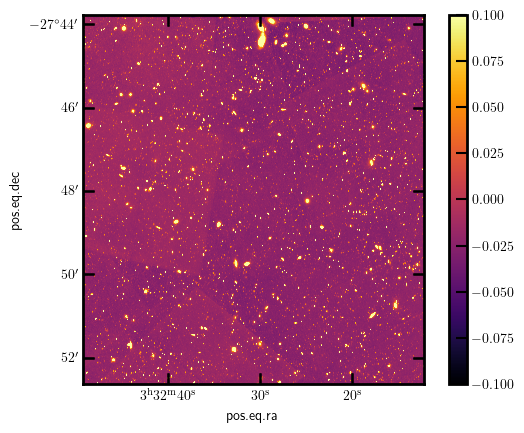

In [161]:
fig = plt.subplot(projection=wcs)
plt.imshow(f0[0].data, vmax=0.1, vmin=-0.1, origin='lower', cmap='inferno')
plt.colorbar()
plt.show()

In [162]:
def cutout_centered_on_local_peak_with_background_rms(
    image_data_filt0, wts_data_filt0, image_data_filt1, wts_data_filt1, position, size):
    """
    Create a cutout image around a specified RA/Dec, find the peak flux within
    this region, recenter a cutout around the peak, and calculate the RMS noise
    of the background away from the central source.

    Parameters:
    - image_data (2D array): Input image data with flux density values.
    - wcs (WCS): WCS information for the input image.
    - position (tuple): RA and Dec of the center to look around, in degrees.
    - size (int or tuple): Cutout size, in pixels. Should be an integer or (ny, nx).
    - annulus_distance (astropy Quantity): Distance from the peak to the inner edge of the annulus (e.g., 40 * u.arcsec).
    - annulus_width (astropy Quantity): Width of the annulus (e.g., 20 * u.arcsec).

    Returns:
    - peak_cutout_data (2D array): Final cutout image data centered on peak flux.
    - peak_cutout_wcs (WCS): Updated WCS information for the final cutout.
    - background_rms (float): RMS noise level estimated from the background.
    """
    # Convert RA/Dec to pixel coordinates for the initial center
    coord = SkyCoord(ra=position[0]*u.deg, dec=position[1]*u.deg, frame='icrs')
    wcs = WCS(image_data_filt0[0])
    initial_center_pix = wcs.world_to_pixel(coord)
    
    # Step 1: Create an initial cutout around the specified RA/Dec position
    
    initial_cutout = Cutout2D(image_data_filt0[0].data, initial_center_pix, size, wcs=wcs)
    
    # Step 2: Find the local peak within the initial cutout
    peak_position_cutout = np.unravel_index(np.argmax(initial_cutout.data), initial_cutout.data.shape)
    
    # Calculate global pixel coordinates of the peak position
    peak_position_global = (initial_cutout.origin_original[0] + peak_position_cutout[1],
                            initial_cutout.origin_original[1] + peak_position_cutout[0])
    
    # Step 3: Create a new cutout centered on the peak position
    peak_cutout_filt0 = Cutout2D(image_data_filt0[0].data, peak_position_global, size, wcs=wcs)
    peak_cutout_wts0  = Cutout2D(wts_data_filt0[0].data, peak_position_global, size, wcs=wcs)
    peak_cutout_filt1 = Cutout2D(image_data_filt1[0].data, peak_position_global, size, wcs=wcs)
    peak_cutout_wts0  = Cutout2D(wts_data_filt1[0].data, peak_position_global, size, wcs=wcs)
    
    # Step 4: Convert annulus distance and width from angular units to pixels
    #annulus_distance_pix = annulus_distance.to(u.deg) / abs(wcs.pixel_scale_matrix[1, 1])  # Convert to pixels
    #annulus_width_pix = annulus_width.to(u.deg) / abs(wcs.pixel_scale_matrix[1, 1])       # Convert to pixels
    
    # Calculate the inner and outer radius in pixels
    #annulus_inner_radius = annulus_distance_pix.value
    #annulus_outer_radius = (annulus_distance_pix + annulus_width_pix).value
    
    # Step 5: Define the background annulus mask within the cutout
    #y, x = np.ogrid[:peak_cutout.data.shape[0], :peak_cutout.data.shape[1]]
    #distance_from_peak = np.sqrt((x - peak_cutout.data.shape[1] // 2)**2 + (y - peak_cutout.data.shape[0] // 2)**2)
    #background_mask = (distance_from_peak >= annulus_inner_radius) & (distance_from_peak <= annulus_outer_radius)
    
    # Calculate the RMS noise in the background annulus, using only pixels within the annulus mask in the cutout
    #background_rms = np.std(peak_cutout.data[background_mask])
    
    # Return the data, WCS, and background RMS for the peak-centered cutout
    return peak_cutout_filt0, peak_cutout_wts0, peak_cutout_filt1, peak_cutout_wts0

def fill_masked_with_noise(image, mask):
    """
    Fills masked regions of an image with noise matching the unmasked regions.

    Parameters:
    - image (numpy.ndarray): The input image.
    - mask (numpy.ndarray): A boolean mask where True indicates masked pixels.

    Returns:
    - numpy.ndarray: The image with masked regions filled with noise.
    """
    if image.shape != mask.shape:
        raise ValueError("Image and mask must have the same shape.")

    # Create a masked array
    masked_image = np.ma.masked_array(image, mask=mask)
    
    # Calculate noise level (standard deviation of unmasked pixels)
    noise_level = np.std(masked_image.compressed())
    
    # Generate noise for masked pixels
    random_noise = np.random.normal(loc=0, scale=noise_level, size=image.shape)
    
    # Create a copy of the original image to modify
    noisy_image = image.copy()
    
    # Fill the masked regions with generated noise
    noisy_image[mask] = random_noise[mask]
    
    return noisy_image

def apply_closest_mask(data, segment):
    """
    Applies the closest mask to the centre of the input image and merges all other masks.

    Parameters:
        data (numpy.ndarray): The 2D image array.
        segment (photutils.segmentation.SegmentationImage): The segmentation object.

    Returns:
        masked_image (numpy.ndarray): The image with the closest mask applied.
        closest_mask (numpy.ndarray): The closest mask applied to the image.
        merged_other_masks (numpy.ndarray): A single mask combining all other segments.
    """
    # Determine the centre pixel of the image
    centre_y, centre_x = np.array(data.shape) // 2
    
    # Get the number of segment labels
    nlabels = segment.nlabels
    print(f"Number of segments: {nlabels}")
    if nlabels != 1:
        
        segment_masks = []
        mask_coords = []
        dist_mask = []

        for label in range(1, nlabels + 1):
            # Create a mask for the current label
            current_mask = segment.data == label
            segment_masks.append(current_mask)

            # Get pixel coordinates of the current mask
            mask_coords.append(np.array(np.where(current_mask)).T)

            # Compute the distance from the mask to the centre pixel
            distances = np.sqrt((mask_coords[label - 1][:, 1] - centre_x)**2 +
                                (mask_coords[label - 1][:, 0] - centre_y)**2)
            dist_mask.append(np.min(distances))  # Minimum distance for the current mask

        # Find the closest mask
        dist_mask = np.array(dist_mask)
        closest_mask_ind = int(np.argmin(dist_mask))  # Index of the closest mask
        closest_mask = segment_masks[closest_mask_ind]

        # Merge all other masks
        merged_other_masks = np.logical_or.reduce([mask for idx, mask in enumerate(segment_masks) if idx != closest_mask_ind])

        # Apply the closest mask to the image
        masked_image = np.where(closest_mask, data, np.nan)  # Replace masked regions with NaN
    
    else:
        closest_mask = segment.data == nlabels
        merged_other_masks = np.zeros(shape=data.shape, dtype=bool)
        masked_image = np.where(closest_mask, data, np.nan)
    return masked_image, closest_mask, merged_other_masks


In [163]:
WCS(f0[0])

WCS Keywords

Number of WCS axes: 2
CTYPE : 'RA---TAN' 'DEC--TAN' 
CRVAL : 53.128 -27.8034 
CRPIX : 6144.0 6656.0 
CD1_1 CD1_2  : -1.1111111111111e-05 0.0 
CD2_1 CD2_2  : 0.0 1.1111111111111e-05 
NAXIS : 12288  13312

In [164]:
def get_cuttout_data_arr():    
    peak_cutout_filt0_arr, peak_cutout_wts0_arr, peak_cutout_filt1_arr, peak_cutout_wts0_arr = [],[],[],[]
    for i in range(len(ra)):
        try:
            peak_cutout_filt0, peak_cutout_wts0, peak_cutout_filt1, peak_cutout_wts0 = cutout_centered_on_local_peak_with_background_rms(image_data_filt0=f0,\
                                                                                                                                         wts_data_filt0=fw0,\
                                                                                                                                         image_data_filt1=f1,\
                                                                                                                                         wts_data_filt1=fw1, \
                                                                                                                                         position=[ra[i], \
                                                                                                                                                   dec[i]], \
                                                                                                                                         size=3*u.arcsecond)
            
            peak_cutout_filt0_arr .append(peak_cutout_filt0)
            peak_cutout_wts0_arr  .append(peak_cutout_wts0)  
            peak_cutout_filt1_arr .append(peak_cutout_filt1) 
            peak_cutout_wts0_arr  .append(peak_cutout_wts0) 

        except:
            print('err')
    return peak_cutout_filt0_arr, peak_cutout_wts0_arr, peak_cutout_filt1_arr, peak_cutout_wts0_arr

In [165]:
peak_cutout_filt0_arr, peak_cutout_wts0_arr, peak_cutout_filt1_arr, peak_cutout_wts1_arr = get_cuttout_data_arr()

In [166]:
#primary_hdu = fits.PrimaryHDU(data=peak_cutout_data, header=peak_cutout_wcs.to_header())
#primary_hdu.header = f[0].header
## Step 5: Combine HDUs into an HDUList
#hdulist = fits.HDUList([primary_hdu])

# Step 6: Write the HDUList to a FITS file
#hdulist.writeto('anshu_gal210w.fits', overwrite=True)

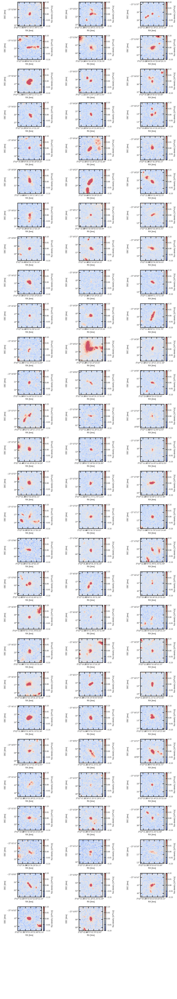

In [154]:
# Set up a figure with a grid of 10 rows and 3 columns
fig, axes = plt.subplots(nrows=len(ra)//3, ncols=3, figsize=(15, len(ra)), subplot_kw={'projection': peak_cutout_filt0_arr[0].wcs})

fig.subplots_adjust(hspace=0.4, wspace=0.4)  # Adjust spacing between subplots
# Loop through each subplot and each image
for i, ax in enumerate(axes.flat):
    if i < len(peak_cutout_filt0_arr):
        # Set the WCS projection for each subplot
        ax = plt.subplot(len(ra)//3, 3, i + 1, projection=peak_cutout_filt0_arr[i].wcs)
        
        # Plot the image with specified limits and color map
        ax.imshow(peak_cutout_filt0_arr[i].data, vmax=0.1, vmin=-0.1, origin='lower', cmap='coolwarm', alpha=0.7, aspect='equal')
        
        # Set labels for each subplot
        ax.set_xlabel('RA [hms]')
        ax.set_ylabel('DEC [dms]')
        
        # Add a color bar to each subplot (optional for each image, could use a single one outside grid)
        cbar = plt.colorbar(ax.images[0], ax=ax, fraction=0.046, pad=0.04)
        cbar.set_label(f'flux-density [{flux_units}]')
    else:
        ax.axis('off')  # Turn off unused subplots if any

# Save the entire figure
#if use_control == True:
#    
#    plt.savefig('source_control_%s.jpg'%filt0)
#else:
#    plt.savefig('source_eelgs_%s.jpg'%filt0)
plt.show()


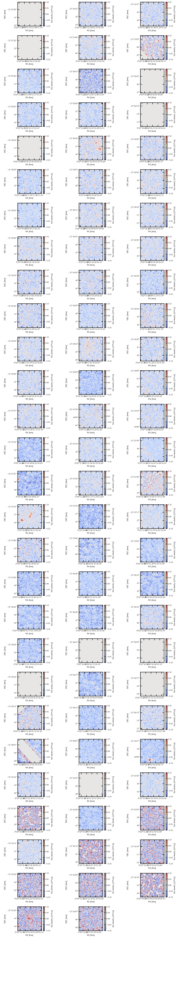

In [155]:
# Set up a figure with a grid of 10 rows and 3 columns
fig, axes = plt.subplots(nrows=len(ra)//3, ncols=3, figsize=(15, len(ra)), subplot_kw={'projection': peak_cutout_filt1_arr[0].wcs})

fig.subplots_adjust(hspace=0.4, wspace=0.4)  # Adjust spacing between subplots
# Loop through each subplot and each image
for i, ax in enumerate(axes.flat):
    if i < len(peak_cutout_filt1_arr):
        # Set the WCS projection for each subplot
        ax = plt.subplot(len(ra)//3, 3, i + 1, projection=peak_cutout_filt1_arr[i].wcs)
        
        # Plot the image with specified limits and color map
        ax.imshow(peak_cutout_filt1_arr[i].data, vmax=0.1, vmin=-0.1, origin='lower', cmap='coolwarm', alpha=0.7, aspect='equal')
        
        # Set labels for each subplot
        ax.set_xlabel('RA [hms]')
        ax.set_ylabel('DEC [dms]')
        
        # Add a color bar to each subplot (optional for each image, could use a single one outside grid)
        cbar = plt.colorbar(ax.images[0], ax=ax, fraction=0.046, pad=0.04)
        cbar.set_label(f'flux-density [{flux_units}]')
    else:
        ax.axis('off')  # Turn off unused subplots if any

# Save the entire figure
if use_control == True:
    
    plt.savefig('source_control_%s.jpg'%filt1)
else:
    plt.savefig('source_eelgs_%s.jpg'%filt1)
plt.show()


# Set up a figure with a grid of 10 rows and 3 columns
fig, axes = plt.subplots(nrows=len(ra)//3, ncols=3, figsize=(15, len(ra)), subplot_kw={'projection': peak_cutout_wcs_arr[0]})

fig.subplots_adjust(hspace=0.4, wspace=0.4)  # Adjust spacing between subplots
# Loop through each subplot and each image
for i, ax in enumerate(axes.flat):
    if i < len(peak_cutout_data_arr):
        # Set the WCS projection for each subplot
        ax = plt.subplot(len(ra)//3, 3, i + 1, projection=peak_cutout_wcs_arr[i])
        
        # Plot the image with specified limits and color map
        ax.imshow(peak_cutout_data_arr[i], vmax=0.1, vmin=-0.1, origin='lower', cmap='coolwarm', alpha=0.7, aspect='equal')
        
        # Set labels for each subplot
        ax.set_xlabel('RA [hms]')
        ax.set_ylabel('DEC [dms]')
        
        # Add a color bar to each subplot (optional for each image, could use a single one outside grid)
        cbar = plt.colorbar(ax.images[0], ax=ax, fraction=0.046, pad=0.04)
        cbar.set_label(f'flux-density [{flux_units}]')
    else:
        ax.axis('off')  # Turn off unused subplots if any

# Save the entire figure
#if use_control == True:
#    
#    plt.savefig('source_control_%s.jpg'%filt)
#else:
#    plt.savefig('source_eelgs_%s.jpg'%filt)
plt.show()


In [169]:
def get_segments_background(peak_cutout_data_arr):  
    bkg_estimator = SExtractorBackground()
    segment_map_arr    = []
    data_sub_arr       = []
    convolved_data_arr = []
    for i in range(len(ra)):
        try:
            bkg = Background2D(peak_cutout_data_arr[i], box_size=(10, 10), filter_size=(3, 3),
                               bkg_estimator=bkg_estimator)
            data_sub_arr.append (peak_cutout_data_arr[i] - bkg.background)  # subtract the background
            #threshold = 1.5 * bkg.background_rms
    
            kernel = make_2dgaussian_kernel(2.5, size=3)  # FWHM = 3.0
            convolved_data_arr .append (convolve(data_sub_arr[i], kernel))
            mean, median, std = sigma_clipped_stats(data_sub_arr[i], sigma=3.0) 
    
            segment_map_arr .append(detect_sources(convolved_data_arr[i], threshold=std, npixels=10))
        except:
            print('err', i)
            
    
    segm_deblend_arr=[]
    for i in range(len(ra)):
        try:
            segm_deblend_arr .append( deblend_sources(convolved_data_arr[i], segment_map_arr[i],
                                           npixels=10, nlevels=32, contrast=0.0001,
                                           progress_bar=False))
        except:
            print('err', i)
            
    background_filled_arr = []
    for i in range(len(ra)):
        try:
            background_filled_arr .append(fill_masked_with_noise(image=data_sub_arr[i],\
                                                             mask=~segm_deblend_arr[i].data_ma.mask))
        except:
            print('err', i)
    
    masked_image_arr, closest_mask_arr, merged_other_masks_arr = [], [], []
    for i in range(len(ra)):
        try:
            masked_image, closest_mask, merged_other_masks = apply_closest_mask(data=data_sub_arr[i],\
                                                                                segment=segm_deblend_arr[i])
            masked_image_arr.append(masked_image)
            closest_mask_arr.append(closest_mask)
            merged_other_masks_arr.append(merged_other_masks)
        
        except:
            print('err', i)
            
    background_filled_arr2 = []
    for i in range(len(ra)):
        try:
            background_filled_arr2 .append(fill_masked_with_noise(image=data_sub_arr[i],\
                                                             mask=merged_other_masks_arr[i]))
        except:
            print('err', i)
            
    background_filled_arr3 = []
    for i in range(len(ra)):
        try:
            #indic = np.argwhere(closest_mask_arr[i] == True) 
            #background_filled_arr[i][indic] = data_sub_arr[i][indic]
            background_filled_arr3 .append(np.ma.masked_array(background_filled_arr[i], mask=closest_mask_arr[i], fill_value=np.nan))
            
            #background_filled_arr3[i][indic] = data_sub_arr[i][indic]
            #background_filled_arr3[i] = np.ma.masked_array(b)
            #background_filled_arr3 .append(data_sub_arr[i][closest_mask_arr[i]])
        except:
            print('err', i)
            
    return segm_deblend_arr, data_sub_arr, convolved_data_arr, closest_mask_arr, background_filled_arr2, background_filled_arr3

In [170]:
peak_cutout_filt0_arr_data = [peak_cutout_filt0_arr[i].data for i in range(len(peak_cutout_filt0_arr))]
temp_20 = np.copy(peak_cutout_filt0_arr_data[20])
peak_cutout_filt0_arr_data[20] = np.full((75, 75), np.nan)
peak_cutout_filt0_arr_data[20][:, :] = temp_20

ValueError: could not broadcast input array from shape (52,75) into shape (75,75)

In [28]:
segm_deblend_arr, data_sub_arr, convolved_data_arr, closest_mask_arr, background_filled_arr2, background_filled_arr3 = get_segments_background(peak_cutout_filt0_arr_data)

err 83
err 84
err 85
err 86
err 87
err 88
err 89
err 1
err 2
err 3
err 4
err 6
err 7
err 8
err 11
err 13
err 16
err 17
err 18
err 19
err 22
err 28
err 29
err 31
err 33
err 34
err 36
err 42
err 44
err 45
err 50
err 51
err 52
err 56
err 58
err 60
err 64
err 65
err 66
err 67
err 68
err 69
err 72
err 73
err 74
err 76
err 77
err 78
err 80
err 83
err 84
err 85
err 86
err 87
err 88
err 89
err 41
err 42
err 43
err 44
err 45
err 46
err 47
err 48
err 49
err 50
err 51
err 52
err 53
err 54
err 55
err 56
err 57
err 58
err 59
err 60
err 61
err 62
err 63
err 64
err 65
err 66
err 67
err 68
err 69
err 70
err 71
err 72
err 73
err 74
err 75
err 76
err 77
err 78
err 79
err 80
err 81
err 82
err 83
err 84
err 85
err 86
err 87
err 88
err 89
Number of segments: 4
Number of segments: 3
Number of segments: 3
Number of segments: 4
Number of segments: 4
Number of segments: 1
Number of segments: 1
Number of segments: 5
Number of segments: 5
Number of segments: 3
Number of segments: 3
Number of segments: 3
Number o

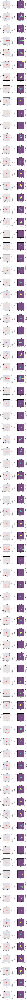

In [41]:
# Set up a grid of 27 rows and 2 columns
fig, axes = plt.subplots(nrows=len(data_sub_arr), ncols=2, figsize=(10, len(data_sub_arr) * 5))

# Adjust spacing between subplots
fig.subplots_adjust(hspace=0.7, wspace=0.4)

# Loop through each pair of images and plot them side by side
for i in range(len(data_sub_arr)):
    # Plot the first image (data_sub_arr) in the left column
    ax0 = plt.subplot(len(data_sub_arr), 2, 2 * i + 1, projection=peak_cutout_filt0_arr[i].wcs)  # Set WCS for this subplot
    ax0.imshow(data_sub_arr[i], vmax=0.1, vmin=-0.1, origin='lower', cmap='coolwarm', alpha=0.7, aspect='equal')
    ax0.set_xlabel('RA [hms]')
    ax0.set_ylabel('DEC [dms]')
    ax0.set_title(f"Source {i + 1}")
    
    # Plot the second image (segment_map_arr) in the right column
    ax1 = plt.subplot(len(data_sub_arr), 2, 2 * i + 2, projection=peak_cutout_filt0_arr[i].wcs)  # Set WCS for this subplot
    ax1.imshow(segm_deblend_arr[i], origin='lower', cmap='viridis', interpolation='nearest', alpha=0.7)
    ax1.set_xlabel('RA [hms]')
    ax1.set_ylabel('DEC [dms]')
    ax1.set_title(f"Segment Map {i + 1}")
    
    # Add a color bar for each subplot (optional)
    cbar0 = plt.colorbar(ax0.images[0], ax=ax0, fraction=0.046, pad=0.04)
    cbar0.set_label('Flux Density [%s]' % flux_units)

    cbar1 = plt.colorbar(ax1.images[0], ax=ax1, fraction=0.046, pad=0.04)
    cbar1.set_label('Segment Value')
# Save the entire figure
if use_control == True:
    
    plt.savefig('source_control_cut_seg_%s.jpg'%filt0)
else:
    plt.savefig('source_eelgs_cut_seg_%s.jpg'%filt0)
plt.show()
# Display the plot
plt.show()


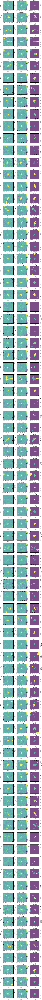

In [42]:
# Set up a grid of 27 rows and 3 columns
fig, axes = plt.subplots(nrows=len(data_sub_arr), ncols=3, figsize=(15, len(data_sub_arr) * 5))

# Adjust spacing between subplots
fig.subplots_adjust(hspace=.3, wspace=.3)

# Loop through each set of images and plot them in the corresponding row
for i in range(len(data_sub_arr)):
    # Plot the first image (data_sub_arr) in the left column
    ax0 = plt.subplot(len(data_sub_arr), 3, 3 * i + 1, projection=peak_cutout_filt0_arr[i].wcs)  # Set WCS for this subplot
    ax0.imshow(data_sub_arr[i], vmax=0.1, vmin=-0.1, origin='lower', cmap='viridis', alpha=0.7, aspect='equal')
    ax0.set_xlabel('RA [hms]')
    ax0.set_ylabel('DEC [dms]')
    ax0.set_title(f"Source {i + 1}")
    
    # Plot the second image (background_filled_arr) in the middle column
    ax1 = plt.subplot(len(data_sub_arr), 3, 3 * i + 2, projection=peak_cutout_filt0_arr[i].wcs)  # Set WCS for this subplot
    ax1.imshow(background_filled_arr2[i], vmax=0.1, vmin=-0.1, origin='lower', cmap='viridis', alpha=0.7)
    ax1.set_xlabel('RA [hms]')
    ax1.set_ylabel('DEC [dms]', visible=False)
    ax1.set_title(f"Source Subtracted {i + 1}")
    
    # Plot the third image (segment_map_arr) in the right column
    ax2 = plt.subplot(len(data_sub_arr), 3, 3 * i + 3, projection=peak_cutout_filt0_arr[i].wcs)  # Set WCS for this subplot
    ax2.imshow(segm_deblend_arr[i], origin='lower', cmap='viridis', interpolation='nearest', alpha=0.7)
    ax2.set_xlabel('RA [hms]')
    ax2.set_ylabel('DEC [dms]', visible=False)
    ax2.set_title(f"Segment Map {i + 1}")
    
    # Add a color bar for each subplot
    cbar0 = plt.colorbar(ax0.images[0], ax=ax0, fraction=0.046, pad=0.04)
    cbar0.set_label('Flux Density [%s]' % flux_units)

    cbar1 = plt.colorbar(ax1.images[0], ax=ax1, fraction=0.046, pad=0.04)
    cbar1.set_label('Background Level')

    cbar2 = plt.colorbar(ax2.images[0], ax=ax2, fraction=0.046, pad=0.04)
    cbar2.set_label('Segment Value')

# Save the entire figure
if use_control:
    plt.savefig(f'source_control_cut_seg_rem_src_{filt0}.jpg')
else:
    plt.savefig(f'source_eelgs_cut_seg_rem_src_{filt0}.jpg')

# Display the plot
plt.show()


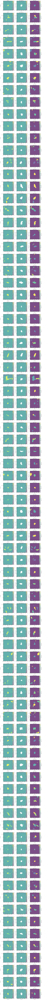

In [43]:
# Set up a grid of 27 rows and 3 columns
fig, axes = plt.subplots(nrows=len(data_sub_arr), ncols=3, figsize=(15, len(data_sub_arr) * 5))

# Adjust spacing between subplots
fig.subplots_adjust(hspace=.3, wspace=.3)

# Loop through each set of images and plot them in the corresponding row
for i in range(len(data_sub_arr)):
    # Plot the first image (data_sub_arr) in the left column
    ax0 = plt.subplot(len(data_sub_arr), 3, 3 * i + 1, projection=peak_cutout_filt0_arr[i].wcs)  # Set WCS for this subplot
    ax0.imshow(data_sub_arr[i], vmax=0.1, vmin=-0.1, origin='lower', cmap='viridis', alpha=0.7, aspect='equal')
    ax0.set_xlabel('RA [hms]')
    ax0.set_ylabel('DEC [dms]')
    ax0.set_title(f"Source {i + 1}")
    
    # Plot the second image (background_filled_arr) in the middle column
    ax1 = plt.subplot(len(data_sub_arr), 3, 3 * i + 2, projection=peak_cutout_filt0_arr[i].wcs)  # Set WCS for this subplot
    ax1.imshow(background_filled_arr3[i], vmax=0.1, vmin=-0.1, origin='lower', cmap='viridis', alpha=0.7)
    ax1.set_xlabel('RA [hms]')
    ax1.set_ylabel('DEC [dms]', visible=False)
    ax1.set_title(f"Source Subtracted {i + 1}")
    
    # Plot the third image (segment_map_arr) in the right column
    ax2 = plt.subplot(len(data_sub_arr), 3, 3 * i + 3, projection=peak_cutout_filt0_arr[i].wcs)  # Set WCS for this subplot
    ax2.imshow(segm_deblend_arr[i], origin='lower', cmap='viridis', interpolation='nearest', alpha=0.7)
    ax2.set_xlabel('RA [hms]')
    ax2.set_ylabel('DEC [dms]', visible=False)
    ax2.set_title(f"Segment Map {i + 1}")
    
    # Add a color bar for each subplot
    cbar0 = plt.colorbar(ax0.images[0], ax=ax0, fraction=0.046, pad=0.04)
    cbar0.set_label('Flux Density [%s]' % flux_units)

    cbar1 = plt.colorbar(ax1.images[0], ax=ax1, fraction=0.046, pad=0.04)
    cbar1.set_label('Background Level')

    cbar2 = plt.colorbar(ax2.images[0], ax=ax2, fraction=0.046, pad=0.04)
    cbar2.set_label('Segment Value')

# Save the entire figure
if use_control:
    plt.savefig(f'source_control_cut_seg_rem_src_{filt0}.jpg')
else:
    plt.savefig(f'source_eelgs_cut_seg_rem_src_{filt0}.jpg')

# Display the plot
plt.show()


## flux analysis

In [159]:
peak_cutout_filt1_arr_data = [peak_cutout_filt1_arr[i].data for i in range(len(peak_cutout_filt1_arr))]

In [160]:
temp_w20 = np.copy(peak_cutout_filt1_arr_data[20])
print(temp_w20.shape)
peak_cutout_filt1_arr_data[20] = np.full((75, 75), np.nan)
peak_cutout_filt1_arr_data[20][:, :] = temp_w20

(75, 75)


In [29]:
temp_20.shape

(75, 75)

In [162]:
for i in range(len(peak_cutout_filt0_arr)):
    print(peak_cutout_filt0_arr_data[i].shape, peak_cutout_filt1_arr_data[i].shape, peak_cutout_wts0_arr[i].data.shape, peak_cutout_wts1_arr[i].data.shape, background_filled_arr3[i].shape)

(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (75, 75) (75, 75) (75, 75) (75, 75)
(75, 75) (

IndexError: list index out of range

In [50]:
def get_flux(data, wts, bg_mask):
    
    data_main       = []
    wts_main        = []
    flux_data = []
    flux_wts  = []
    for i in range(len(bg_mask)):
        data_main.append( np.ma.masked_array(data[i], mask=~bg_mask[i].mask, fill_value=np.nan) )
        wts_main .append( np.ma.masked_array(wts[i].data , mask=~bg_mask[i].mask, fill_value=np.nan) )
        
        print(np.sum(~bg_mask[i].mask),'masked pixels')
    data_main
    
    return data_main, wts_main

In [51]:
filt0_data, filt0_wts = get_flux(data=peak_cutout_filt0_arr_data, wts=peak_cutout_wts0_arr, bg_mask=background_filled_arr3)
filt1_data, filt1_wts = get_flux(data=peak_cutout_filt1_arr_data, wts=peak_cutout_wts1_arr, bg_mask=background_filled_arr3)

5484 masked pixels
5482 masked pixels
5548 masked pixels
5450 masked pixels
5382 masked pixels
5317 masked pixels
5428 masked pixels
5491 masked pixels
5517 masked pixels
5427 masked pixels
5491 masked pixels
5511 masked pixels
5525 masked pixels
5410 masked pixels
5430 masked pixels
5285 masked pixels
5379 masked pixels
5406 masked pixels
5334 masked pixels
5529 masked pixels
5424 masked pixels
5468 masked pixels
5429 masked pixels
5305 masked pixels
5369 masked pixels
5583 masked pixels
5470 masked pixels
5509 masked pixels
5370 masked pixels
5357 masked pixels
5480 masked pixels
5428 masked pixels
5445 masked pixels
5497 masked pixels
5491 masked pixels
5470 masked pixels
5473 masked pixels
5481 masked pixels
5455 masked pixels
5395 masked pixels
5517 masked pixels
5515 masked pixels
5311 masked pixels
5468 masked pixels
5371 masked pixels
5447 masked pixels
5428 masked pixels
5455 masked pixels
5448 masked pixels
5486 masked pixels
5501 masked pixels
5423 masked pixels
5474 masked 

In [55]:
background_filled_arr3[0].shape

(75, 75)

In [56]:
noise_std = []
for i in range(len(background_filled_arr3)):
    noise_std.append(np.nanstd(background_filled_arr3[i]))
noise_std = np.array(noise_std)

In [57]:
if use_control==True:
    np.save('err_arr_%s_%s'%('control', filt), noise_std)
else:
    np.save('err_arr_%s_%s'%('EELGS', filt), noise_std)

In [58]:
closest_mask_arr = np.array(closest_mask_arr, dtype=object)

In [59]:
filt

'F814W'

In [60]:
if use_control==True:
    np.save('closest_mask_arr_%s_%s'%('control', filt), closest_mask_arr)
else:
    np.save('closest_mask_arr_%s_%s'%('EELGS', filt), closest_mask_arr)

In [61]:
use_control

True

In [62]:
if use_control==True:
    filt='F814W'
    closest_mask_arr = np.load('closest_mask_arr_%s_%s.npy'%('control', filt), allow_pickle=True)
else:
    filt='F814W'
    closest_mask_arr = np.load('closest_mask_arr_%s_%s.npy'%('EELGS', filt), allow_pickle=True)
#closest_mask_arr = np.load('closest_mask_arr_control_F814W.npy', allow_pickle=True)

In [63]:
closest_mask_arr.shape, len(data_sub_arr)

((83, 75, 75), 83)

In [64]:
def flux_estimator(data, mask):
    
    arr =  np.ma.masked_array(data, mask)
    print(np.sum(mask), 'masking pixels')
    return np.sum(arr)

In [65]:
closest_mask_arr[0].shape

(75, 75)

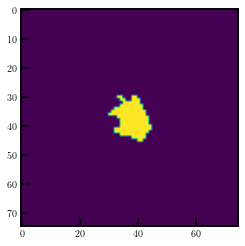

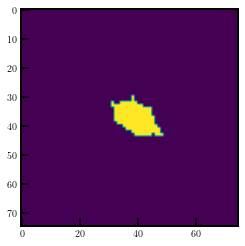

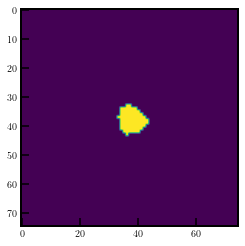

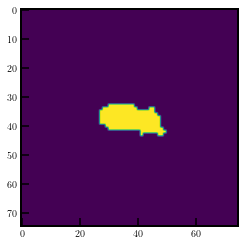

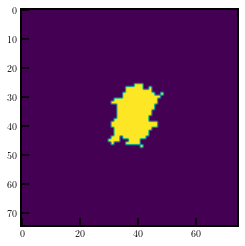

...

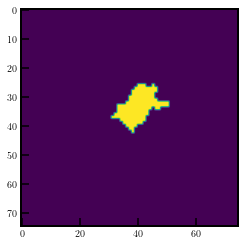

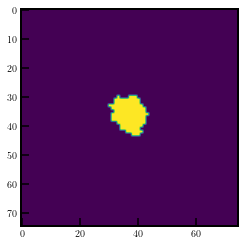

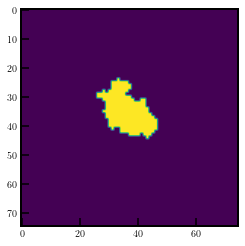

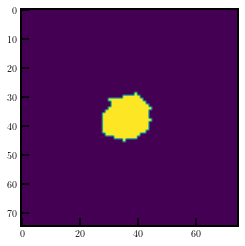

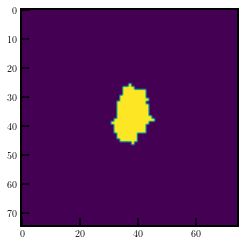

In [66]:
for i in range(len(data_sub_arr)):
    plt.imshow(closest_mask_arr[i].astype(bool))
    plt.show()

In [67]:
flux_814 = []
for i in range(len(ra)):
    try:
        print(i)
        flux_814 . append ( flux_estimator(data=data_sub_arr[i], mask=~closest_mask_arr[i].astype(bool)) )
    except:
        print(i, 'err')
flux_814 = np.array(flux_814)

0
5484 masking pixels
1
5482 masking pixels
2
5548 masking pixels
3
5450 masking pixels
4
5382 masking pixels
5
5317 masking pixels
6
5428 masking pixels
7
5491 masking pixels
8
5517 masking pixels
9
5427 masking pixels
10
5491 masking pixels
11
5511 masking pixels
12
5525 masking pixels
13
5410 masking pixels
14
5430 masking pixels
15
5285 masking pixels
16
5379 masking pixels
17
5406 masking pixels
18
5334 masking pixels
19
5529 masking pixels
20
5424 masking pixels
21
5468 masking pixels
22
5429 masking pixels
23
5305 masking pixels
24
5369 masking pixels
25
5583 masking pixels
26
5470 masking pixels
27
5509 masking pixels
28
5370 masking pixels
29
5357 masking pixels
30
5480 masking pixels
31
5428 masking pixels
32
5445 masking pixels
33
5497 masking pixels
34
5491 masking pixels
35
5470 masking pixels
36
5473 masking pixels
37
5481 masking pixels
38
5455 masking pixels
39
5395 masking pixels
40
5517 masking pixels
41
5515 masking pixels
42
5311 masking pixels
43
5468 masking pixel

In [68]:
flux_814

array([ 15.14237785,  18.81327438,   6.43974209,  17.88117599,
        18.91485214,  47.58709335,  43.43011093,  13.19389534,
         8.09601021,  18.39477539,  13.67742157,  12.36229134,
        11.51591492,  45.79653549,  21.04076385,  37.53559113,
        41.08310318,  27.00971603,  22.04244423,   7.47681713,
        11.97851478,  17.86856079,  22.69742203,  19.59672546,
        46.02407074,   1.2728101 ,  16.44739342,  10.05967045,
        26.99430466,  23.52015686,   8.24752617,  41.91495895,
        13.82966232,  12.65647507,   7.54581547,  11.41098309,
        11.81550884,   9.24385357,   6.11824512,  37.49112701,
        12.50296402,   4.18475628,  37.42120361,  13.19295502,
        22.48468781,   9.85840034,  11.55581284,  14.16771126,
        17.85155869,  11.38460922,  12.54414749,  46.84475708,
        11.73446846,   6.56590223,  14.35484219,   5.56829453,
         3.07244778,  19.1373291 ,  14.84775543,   8.43691063,
        29.04778481,  21.36435318,  16.97470665, 105.89

In [69]:
use_control

True

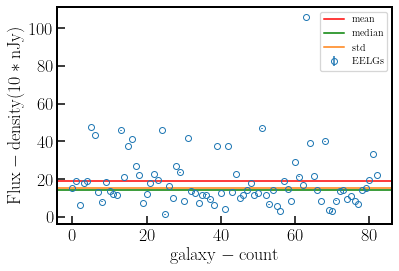

In [70]:
plt.figure(figsize=(6,4))
plt.xticks(size=18)
plt.yticks(size=18)
plt.ylabel(r'$\rm Flux-density (10*n Jy)$', size=18)
plt.xlabel(r'$\rm galaxy- count$', size=18)
plt.errorbar(x=np.arange(flux_814.size), y = flux_814, yerr=3*noise_std, ls = '', marker='o', fillstyle='none', label=r'$\rm EELGs$')
plt.axhline(np.nanmean(flux_814), color='r', label=r'$\rm mean$')
plt.axhline(np.nanmedian(flux_814), color='g', label=r'$\rm median$')
plt.axhline(np.nanstd(flux_814) , color='C1', label=r'$\rm std$')
plt.legend(loc='best')
if use_control==True:
    plt.savefig('Control_flux_%s.jpg'%filt, dpi=120, bbox_inches='tight')
else:
    plt.savefig('EELGS_flux_%s.jpg'%filt, dpi=120, bbox_inches='tight')

In [71]:
wtd=True
if wtd == True:
    if use_control==True:
        np.savetxt('Control_flux_%s_wtd'%filt, flux_814)
    else:
        np.savetxt('EELGS_flux_%s_wtd'%filt, flux_814)
else:
    if use_control==True:
        np.savetxt('Control_flux_%s'%filt, flux_814)
    else:
        np.savetxt('EELGS_flux_%s'%filt, flux_814)    

In [72]:
filt

'F814W'

In [73]:
flux814_EELGS = np.loadtxt('EELGS_flux_%s'%'F814W')
flux336_EELGS = np.loadtxt('EELGS_flux_%s'%'F336W')
flux814_CTRL  = np.loadtxt('Control_flux_%s'%'F814W')
flux336_CTRL  = np.loadtxt('Control_flux_%s'%'F336W')

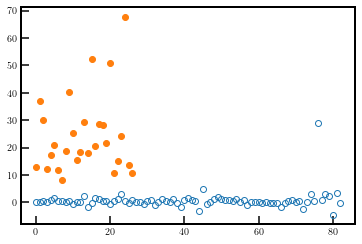

In [74]:
plt.plot(flux814_CTRL, 'o', fillstyle='none',)
plt.plot(flux814_EELGS, 'o', )

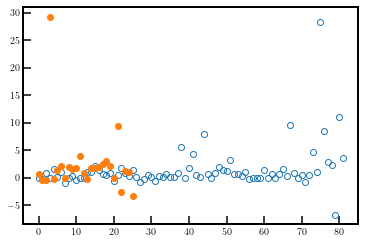

In [75]:
plt.plot(flux336_CTRL, 'o', fillstyle='none',)
plt.plot(flux336_EELGS, 'o',)

(array([0.04044699, 0.04044699, 0.04853639, 0.0161788 , 0.03235759,
        0.        , 0.0161788 , 0.        , 0.        , 0.0161788 ,
        0.        , 0.        , 0.0080894 ]),
 array([ 8.24825191, 12.82671855, 17.40518519, 21.98365182, 26.56211846,
        31.14058509, 35.71905173, 40.29751836, 44.875985  , 49.45445163,
        54.03291827, 58.61138491, 63.18985154, 67.76831818]),
 <BarContainer object of 13 artists>)

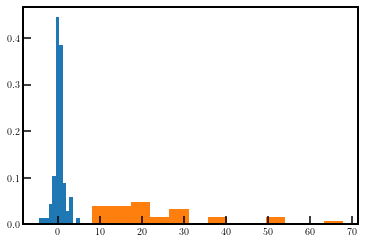

In [76]:
plt.hist(flux814_CTRL, bins=flux814_CTRL.size//2, density=True)
plt.hist(flux814_EELGS, bins=flux814_EELGS.size//2, density=True)

(array([0.03070102, 0.23025763, 0.10745356, 0.        , 0.        ,
        0.01535051, 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.01535051]),
 array([-3.31503725, -0.80948257,  1.6960721 ,  4.20162678,  6.70718145,
         9.21273613, 11.71829081, 14.22384548, 16.72940016, 19.23495483,
        21.74050951, 24.24606419, 26.75161886, 29.25717354]),
 <BarContainer object of 13 artists>)

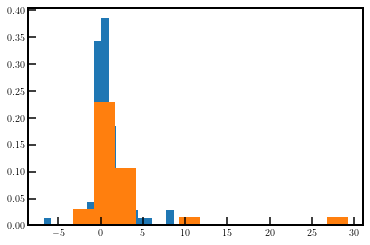

In [77]:
plt.hist(flux336_CTRL, bins=flux814_CTRL.size//2, density=True)
plt.hist(flux336_EELGS, bins=flux814_EELGS.size//2, density=True)

# galaxy matching catalogue

In [171]:
datapath = '/media/himanshu/MyHDD/data_galaxy_evolution'
c0 = fits.open(datapath+'/data/catalog/hlsp_jades_jwst_nircam_goods-s-deep_photometry_v2.0_catalog.fits')
c1 = fits.open(datapath+'/data/catalog/hlsp_jades_jwst_nirspec_goods-s-deephst_clear-prism_line-fluxes_v1.0_catalog.fits')
c2 = fits.open(datapath+'/data/catalog/hlsp_jades_jwst_nirspec_goods-s-deephst_gratings_line-fluxes_v1.0_catalog.fits')
c3 = fits.open(datapath+'/data/catalog/hlsp_jades_jwst_nirspec_goods-s_gratings-line-fluxes_v1.1_catalog.fits')
c4 = fits.open(datapath+'/data/catalog/hlsp_jades_jwst_nirspec_goods-s_prism-line-fluxes_v1.1_catalog.fits')
def find_galaxy(catalog, ra_target, dec_target, tolerance=1e-6):
    """
    Find a galaxy in a catalog by matching RA and DEC within a specified tolerance.

    Parameters:
        catalog (list of dict): The catalog, where each entry is a dictionary with 'RA' and 'DEC'.
        ra_target (float): The RA of the galaxy to match.
        dec_target (float): The DEC of the galaxy to match.
        tolerance (float): The tolerance for matching RA and DEC (default: 1e-6 degrees).

    Returns:
        list of dict: A list of galaxies matching the target RA and DEC.
    """
    matched_galaxies = []

    for galaxy in catalog:
        ra_diff = abs(galaxy['RA'] - ra_target)
        dec_diff = abs(galaxy['DEC'] - dec_target)
        
        # Check if both RA and DEC differences are within the tolerance
        if ra_diff <= tolerance and dec_diff <= tolerance:
            matched_galaxies.append(galaxy['ID'])
    
    return matched_galaxies

In [172]:
matching_IDS = []
tol=0.0003
for i in range(data.size):
    if use_control==True:
        AA = find_galaxy(catalog=c0[2].data, ra_target=data['RA'][i], dec_target=data['dec'][i], tolerance=tol)
    else:
        AA = find_galaxy(catalog=c0[2].data, ra_target=data['ra'][i], dec_target=data['dec'][i], tolerance=tol)

    print(AA)
    matching_IDS.append([AA, data[i]['id']])

[213117]
[191576, 290769]
[193912]
[118801, 250163, 276870, 291441, 291448, 298064]
[119849, 120307]
[]
[128833, 209048, 209051, 285986, 297450, 297451]
[84547, 191410, 191411]
[108387, 108396, 108405, 271150, 295251]
[112989, 113040, 113205]
[124489, 124772, 124812]
[210693]
[135967, 291660]
[136442, 211968, 211970]
[212376]
[212998]
[144398, 144429]
[148771]
[216984, 216987]
[152057]
[]
[190447]
[96280, 196298, 280724, 280729]
[193009, 193010]
[193310, 193311]
[204094, 204095]
[152457, 152464]


In [173]:
len(matching_IDS)

27

In [174]:
matching_IDS

[[[213117], 20366.0],
 [[191576, 290769], 11462.0],
 [[193912], 12533.0],
 [[118801, 250163, 276870, 291441, 291448, 298064], 17189.0],
 [[119849, 120307], 17342.0],
 [[], 18561.0],
 [[128833, 209048, 209051, 285986, 297450, 297451], 18742.0],
 [[84547, 191410, 191411], 11398.0],
 [[108387, 108396, 108405, 271150, 295251], 15097.0],
 [[112989, 113040, 113205], 15992.0],
 [[124489, 124772, 124812], 18053.0],
 [[210693], 19437.0],
 [[135967, 291660], 19843.0],
 [[136442, 211968, 211970], 19863.0],
 [[212376], 20011.0],
 [[212998], 20257.0],
 [[144398, 144429], 21143.0],
 [[148771], 21896.0],
 [[216984, 216987], 22136.0],
 [[152057], 22731.0],
 [[], 24528.0],
 [[190447], 10936.0],
 [[96280, 196298, 280724, 280729], 13203.0],
 [[193009, 193010], 11999.0],
 [[193310, 193311], 12030.0],
 [[204094, 204095], 16603.0],
 [[152457, 152464], 22839.0]]

In [175]:
matching_indices=[]
for i in range(len(matching_IDS)):
    if len(matching_IDS[i][0]) > 1:
        matching_indices_0 = []
        for j in range(len(matching_IDS[i][0])):
            matching_indices_0.append(np.where(matching_IDS[i][0][j] == c0[-1].data['ID'])[0][0])
        cat_ind = np.where(matching_IDS[i][1] == data['id'])[0][0]
        matching_indices.append([matching_indices_0, cat_ind])
    elif len(matching_IDS[i][0]) < 1:
        print('empty match')
        cat_ind = np.where(matching_IDS[i][1] == data['id'])[0][0]
        matching_indices.append([[], cat_ind])
    else:
        cat_ind = np.where(matching_IDS[i][1] == data['id'])[0][0]
        matching_indices.append([[np.where(matching_IDS[i][0] == c0[-1].data['ID'])[0][0]], cat_ind])
    

empty match
empty match


In [176]:
matching_indices

[[[67265], 0],
 [[59173, 86306], 1],
 [[60043], 2],
 [[35099, 73799, 80431, 86978, 86985, 93601], 3],
 [[35444, 35611], 4],
 [[], 5],
 [[38976, 65946, 65947, 84352, 92987, 92988], 6],
 [[20636, 59121, 59122], 7],
 [[30190, 30195, 30198, 79207, 90788], 8],
 [[32394, 32417, 32482], 9],
 [[36996, 37111, 37128], 10],
 [[66533], 11],
 [[41057, 87197], 12],
 [[41158, 66913, 66914], 13],
 [[67051], 14],
 [[67222], 15],
 [[44002, 44015], 16],
 [[45440], 17],
 [[68713, 68714], 18],
 [[46875], 19],
 [[], 20],
 [[58720], 21],
 [[25117, 60888, 81711, 81714], 22],
 [[59699, 59700], 23],
 [[59793, 59794], 24],
 [[64068, 64069], 25],
 [[47054, 47057], 26]]

In [177]:
matching_indices = np.array(matching_indices, dtype=object)

In [178]:
use_control

False

In [179]:
if use_control==True:
    np.save('cat_matching_index_tol_control_%s'%tol, matching_indices,)
else:
    np.save('cat_matching_index_tol_eelgs_%s'%tol, matching_indices,)

In [171]:
#checking_redshifts
matching_redshifts = []
for i in range(len(matching_indices)):
    if len(matching_indices[i][0]) < 1:
        cat_z = [data['zphot'][matching_indices[i][1]], data['zspec'][matching_indices[i][1]]]
        matching_redshifts.append([[np.nan], cat_z])
        
    elif len(matching_indices[i][0]) > 1:
        match_z = []
        for j in range(len(matching_indices[i])):
            
            match_z.append(c0[-1].data['EAZY_z_a'][matching_indices[i][0][j]])
            
        print(match_z)
        cat_z = [data['zphot'][matching_indices[i][1]], data['zspec'][matching_indices[i][1]]]
        matching_redshifts.append([match_z, cat_z])
    else:
        cat_z = [data['zphot'][matching_indices[i][1]], data['zspec'][matching_indices[i][1]]]
        match_z = c0[-1].data['EAZY_z_a'][matching_indices[i][0][0]]
        print(match_z)
        matching_redshifts.append([[match_z], cat_z])


3.22
[3.41, 3.44]
3.36
3.72
3.61
[3.4, 3.36]
3.36
3.41
3.95
[3.71, 3.57]
3.38
3.37
3.1
3.37
3.75
3.36
3.36
[3.64, 3.64]
0.41
3.47
3.76
3.11
3.65
2.96
3.68
3.36
3.71
3.12
3.14
3.52
3.66
3.82
3.41
3.1
3.45
3.51
3.8
3.12
3.45
3.45
3.14
3.34
3.54
3.1
3.64
3.21
3.55
[3.28, 3.31]
3.69
3.31
3.36
[3.36, 3.33]
3.9
3.36
3.61
3.41
3.43
3.14
3.6
1.6
[3.21, 3.23]
3.81
3.9
3.5
3.36
3.36
4.24
3.15
3.11
3.38
3.58
3.37
3.17


In [173]:
matching_redshifts

[[[3.22], [3.227, 3.1437]],
 [[3.41, 3.44], [3.421, 3.2009]],
 [[nan], [3.227, 3.13]],
 [[3.36], [3.51, 3.8305]],
 [[3.72], [3.647, 3.5999]],
 [[3.61], [3.532, 3.5815]],
 [[3.4, 3.36], [3.29, 3.3117]],
 [[3.36], [3.29, 3.2122]],
 [[3.41], [3.532, 3.5507]],
 [[3.95], [3.788, 3.6485]],
 [[3.71, 3.57], [3.624, 3.5922]],
 [[3.38], [3.377, 3.2669]],
 [[3.37], [3.082, 3.1314]],
 [[3.1], [3.143, 3.1718233378263454]],
 [[3.37], [3.206, 3.33]],
 [[3.75], [3.67, 3.669215]],
 [[3.36], [3.355, 3.1626]],
 [[3.36], [3.312, 3.2338]],
 [[nan], [3.227, 3.1631]],
 [[3.64, 3.64], [3.51, 3.6531]],
 [[0.41], [3.377, 3.4157]],
 [[3.47], [3.578, 3.4676165504256877]],
 [[3.76], [3.764, 3.6956766319516876]],
 [[nan], [3.717, 3.705]],
 [[3.11], [3.143, 3.0998]],
 [[3.65], [3.578, 3.6017]],
 [[2.96], [3.465, 3.59227]],
 [[3.68], [3.67, 3.7005]],
 [[3.36], [3.123, 3.1589]],
 [[3.71], [3.717, 3.7083]],
 [[3.12], [3.227, 3.1696298695021268]],
 [[3.14], [3.001, 3.1910446355173674]],
 [[nan], [3.443, 3.552413]],
 [[n

In [174]:
abs(matching_redshifts[1][0] - matching_redshifts[1][1][0])

array([0.011, 0.019])

In [175]:
predicted_match = []
for i in range(len(matching_redshifts)):
    #print(matching_redshifts[i])
    A = abs(matching_redshifts[i][0] - matching_redshifts[i][1][0])
    ind = np.where(A == A.min())
    if np.isnan(A[0]) == True:
        pass
    else:
        
        predicted_match.append([matching_indices[i][0][ind[0][0]], matching_redshifts[i][0][ind[0][0]], \
                                matching_redshifts[i][1][0], matching_redshifts[i][1][1]])
predicted_match = np.array(predicted_match)

In [176]:
predicted_match

array([[5.28680000e+04, 3.22000000e+00, 3.22700000e+00, 3.14370000e+00],
       [5.34720000e+04, 3.41000000e+00, 3.42100000e+00, 3.20090000e+00],
       [5.55240000e+04, 3.36000000e+00, 3.51000000e+00, 3.83050000e+00],
       [5.63420000e+04, 3.72000000e+00, 3.64700000e+00, 3.59990000e+00],
       [5.70540000e+04, 3.61000000e+00, 3.53200000e+00, 3.58150000e+00],
       [9.02850000e+04, 3.36000000e+00, 3.29000000e+00, 3.31170000e+00],
       [5.77970000e+04, 3.36000000e+00, 3.29000000e+00, 3.21220000e+00],
       [5.81570000e+04, 3.41000000e+00, 3.53200000e+00, 3.55070000e+00],
       [8.47750000e+04, 3.95000000e+00, 3.78800000e+00, 3.64850000e+00],
       [9.04070000e+04, 3.57000000e+00, 3.62400000e+00, 3.59220000e+00],
       [5.87210000e+04, 3.38000000e+00, 3.37700000e+00, 3.26690000e+00],
       [5.89810000e+04, 3.37000000e+00, 3.08200000e+00, 3.13140000e+00],
       [2.17150000e+04, 3.10000000e+00, 3.14300000e+00, 3.17182334e+00],
       [5.98330000e+04, 3.37000000e+00, 3.20600000e

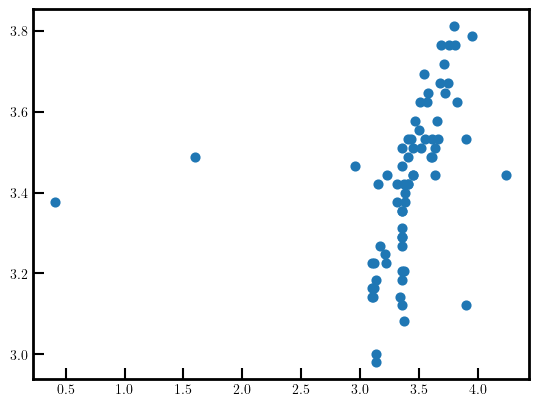

In [177]:
plt.scatter(x=predicted_match[:,1], y=predicted_match[:,2])

In [178]:
catalog_ids = c0[-1].data['ID']
phot_z      = c0[-1].data['EAZY_z_a']
z_68l       = c0[-1].data['EAZY_l68']
z_68u       = c0[-1].data['EAZY_u68']
z_95l       = c0[-1].data['EAZY_l95']
z_95u       = c0[-1].data['EAZY_u95']
z_99l       = c0[-1].data['EAZY_l99']
z_99u       = c0[-1].data['EAZY_u99']
control_ids = data['id'].astype(int)
#ind_ = np.where((z_99u - z_99l) < 0.2)[0]
#

phot_z_arr= []
z_68l_arr = []
z_68u_arr = []
z_95l_arr = []
z_95u_arr = []
z_99l_arr = []
z_99u_arr = []
for i in range(len(predicted_match)):
    #catalog_ids = catalog_ids[ind_]
    
    try:
        print(int(predicted_match[i][0]))
        phot_z_arr     .append(phot_z     [int(predicted_match[i][0])])
        z_68l_arr      .append(z_68l      [int(predicted_match[i][0])])
        z_68u_arr      .append(z_68u      [int(predicted_match[i][0])])
        z_95l_arr      .append(z_95l      [int(predicted_match[i][0])])
        z_95u_arr      .append(z_95u      [int(predicted_match[i][0])])
        z_99l_arr      .append(z_99l      [int(predicted_match[i][0])])
        z_99u_arr      .append(z_99u      [int(predicted_match[i][0])])
    except:
        print(predicted_match[i][0])
phot_z_arr = np.array(phot_z_arr)
z_68l_arr  = np.array(z_68l_arr )
z_68u_arr  = np.array(z_68u_arr )
z_95l_arr  = np.array(z_95l_arr )
z_95u_arr  = np.array(z_95u_arr )
z_99l_arr  = np.array(z_99l_arr )
z_99u_arr  = np.array(z_99u_arr )

52868
53472
55524
56342
57054
90285
57797
58157
84775
90407
58721
58981
21715
59833
71399
60398
60428
60632
60985
61120
61132
61548
61684
61734
27492
27760
62076
62295
28925
62687
63163
63236
63368
63316
63523
32557
63942
63975
34210
64215
64580
64609
35935
36290
36232
65102
65571
92956
65848
38480
65993
66378
66396
66349
66507
66561
66626
66594
40601
66881
93099
67122
72278
67614
43645
67805
68280
68291
45181
93241
68596
46795
48420


In [179]:
phot_z_arr

array([3.22, 3.41, 3.36, 3.72, 3.61, 3.36, 3.36, 3.41, 3.95, 3.57, 3.38,
       3.37, 3.1 , 3.37, 3.75, 3.36, 3.36, 3.64, 0.41, 3.47, 3.76, 3.11,
       3.65, 2.96, 3.68, 3.36, 3.71, 3.12, 3.14, 3.52, 3.66, 3.82, 3.41,
       3.1 , 3.45, 3.51, 3.8 , 3.12, 3.45, 3.45, 3.14, 3.34, 3.54, 3.1 ,
       3.64, 3.21, 3.55, 3.31, 3.69, 3.31, 3.36, 3.36, 3.9 , 3.36, 3.61,
       3.41, 3.43, 3.14, 3.6 , 1.6 , 3.23, 3.81, 3.9 , 3.5 , 3.36, 3.36,
       4.24, 3.15, 3.11, 3.38, 3.58, 3.37, 3.17])

In [180]:
(z_99u_arr - z_99l_arr)

array([0.784, 0.466, 0.282, 1.13 , 0.755, 0.387, 0.362, 0.541, 1.754,
       3.57 , 0.362, 0.285, 0.533, 0.327, 0.838, 0.365, 0.701, 0.704,
       3.481, 0.422, 0.457, 0.782, 0.226, 2.441, 0.874, 0.356, 0.4  ,
       0.83 , 0.42 , 0.505, 0.422, 0.974, 0.347, 0.446, 0.65 , 3.448,
       0.782, 0.505, 3.544, 0.567, 0.494, 0.435, 3.657, 3.38 , 0.408,
       0.344, 0.642, 0.2  , 0.541, 0.512, 3.54 , 0.725, 1.293, 0.28 ,
       0.924, 0.765, 0.599, 0.328, 1.441, 2.937, 0.815, 0.237, 1.53 ,
       0.813, 0.215, 3.856, 1.463, 1.369, 0.87 , 0.367, 0.669, 1.095,
       0.753])

In [181]:
predicted_match.shape

(73, 4)

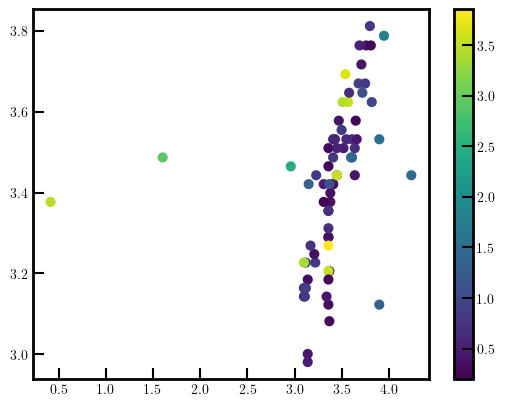

In [182]:
plt.scatter(x=predicted_match[:,1], y=predicted_match[:,2], c= (z_99u_arr - z_99l_arr))
plt.colorbar()

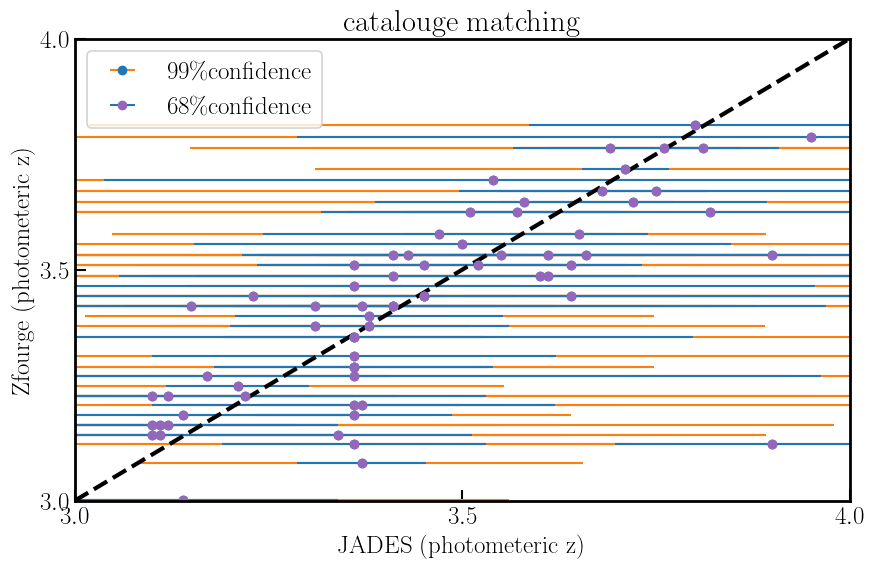

In [183]:
plt.figure(figsize=(10,6))
plt.xlim(3, 4)
plt.ylim(3, 3.9)
plt.xticks([3, 3.5, 4], size=18)
plt.yticks([3, 3.5, 4], size=18)
plt.title(r'\rm catalouge matching', size=22)
plt.xlabel(r'\rm JADES (photometeric z)', size=18)
plt.ylabel(r'\rm Zfourge (photometeric z)', size=18)
plt.errorbar(x=predicted_match[:,1], y=predicted_match[:,2], xerr= (z_99u_arr - z_99l_arr),\
             ls='', marker='o', ecolor='C1', label=r'$99\% \rm confidence$')

plt.errorbar(x=predicted_match[:,1], y=predicted_match[:,2], xerr= (z_68u_arr - z_68l_arr), \
             ls='', marker='o', ecolor='C0', color='C4', label=r'$68\% \rm confidence$')

#plt.errorbar(x=predicted_match[:,1], y=predicted_match[:,3], \
#             ls='', marker='o', ecolor='C0', color='C6', label=r'$\rm Zfourge~spec ~redshift$')

plt.legend(loc='best', fontsize=18)
plt.axline(xy1=(2.5, 2.5), xy2=(4, 4), ls='--', color='k', lw=3)
#plt.plot(np.arange(predicted_match[:,1].shape[0]), np.arange(predicted_match[:,1].shape[0]))
plt.savefig('catalog_comp.jpg', bbox_inches='tight')

In [ ]:
phot_z_arr = np.array(phot_z_arr)
z_68l_arr  = np.array(z_68l_arr )
z_68u_arr  = np.array(z_68u_arr )
z_95l_arr  = np.array(z_95l_arr )
z_95u_arr  = np.array(z_95u_arr )
z_99l_arr  = np.array(z_99l_arr )
z_99u_arr  = np.array(z_99u_arr )

In [109]:
phot_z_arr.shape

(73,)